In [ ]:
!pip install opendatasets

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


# Import

In [ ]:
import opendatasets as od
import pandas as pd
import matplotlib.pyplot as plt
import plotly.graph_objects as go
import plotly.express as px
import seaborn as sns 
import missingno as msno
import random
import numpy as np 

# Download 

In [ ]:
# {"username":"hauth7201","key":"3057ff45efdd5847796be879573f826c"}

path = 'https://www.kaggle.com/datasets/vanviethieuanh/vietnam-weather-data?fbclid=IwAR0I9LPl9GcBESRcLgMkufchT0TD_0pf8vlPzk-qRxcNdvVFUrGeTj28CIM'
od.download(path)

Please provide your Kaggle credentials to download this dataset. Learn more: http://bit.ly/kaggle-creds
Your Kaggle username: hauth7201
Your Kaggle Key: ··········


100%|██████████| 1.88M/1.88M [00:00<00:00, 2.43MB/s]

In [ ]:
path = '/content/vietnam-weather-data/weather.csv'
df = pd.read_csv(path)

In [ ]:
number_of_row = len(df)
print('Number of row:', number_of_row)

Number of row: 181960


# Noising data

In [ ]:
df['date'] = pd.to_datetime(df['date'])
df = df.sort_values(['province', 'date'])

In [ ]:
def noising_data(df, column, frac, value):
  amount = int(number_of_row*frac)

  # index list of sample
  indices = np.random.choice(range(number_of_row), size=amount, replace=False)

  # Change value
  df.loc[indices, column] = value

Add noise to feature

In [ ]:
noising_data(df, 'wind_d', 0.1, None)

In [ ]:
noising_data(df, 'max', 0.01, None)

In [ ]:
noising_data(df, 'humidi', 0.05, None)

# Statistic

In [ ]:
numerical_feature = ['max', 'min', 'wind', 'rain', 'humidi', 'cloud', 'pressure']
nominal_feature = ['province', 'wind_d']
time_series_feature = ['date']

In [ ]:
provinces = df['province'].unique()
print('Number of provinces:', len(provinces))
print('\nData:\n', provinces)

Number of provinces: 40

Data:
 ['Bac Lieu' 'Ho Chi Minh City' 'Tam Ky' 'Ben Tre' 'Hoa Binh' 'Tan An'
 'Bien Hoa' 'Hong Gai' 'Thai Nguyen' 'Buon Me Thuot' 'Hue' 'Thanh Hoa'
 'Ca Mau' 'Long Xuyen' 'Tra Vinh' 'Cam Pha' 'My Tho' 'Tuy Hoa' 'Cam Ranh'
 'Nam Dinh' 'Uong Bi' 'Can Tho' 'Nha Trang' 'Viet Tri' 'Chau Doc'
 'Phan Rang' 'Vinh' 'Da Lat' 'Phan Thiet' 'Vinh Long' 'Ha Noi' 'Play Cu'
 'Vung Tau' 'Hai Duong' 'Qui Nhon' 'Yen Bai' 'Hai Phong' 'Rach Gia'
 'Hanoi' 'Soc Trang']


In [ ]:
wind_d = df['wind_d'].unique()
print('Number of wind direction:', len(wind_d))
print('\nData:\n', wind_d)

Number of wind direction: 17

Data:
 ['NNE' 'ENE' 'E' 'WSW' 'SSE' None 'NE' 'SE' 'ESE' 'SW' 'SSW' 'S' 'W' 'NNW'
 'WNW' 'NW' 'N']


In [ ]:
df.describe()

,max,min,wind,rain,humidi,cloud,pressure
count,181960.000000,181960.000000,181960.000000,181960.000000,181960.000000,181960.000000,181960.000000
mean,29.837277,23.277874,11.038657,6.567130,77.083068,41.721268,1010.229127
std,4.571345,3.945381,5.311807,13.602055,9.288553,23.875067,4.635714
min,4.000000,2.000000,1.000000,0.000000,23.000000,0.000000,988.000000
25%,28.000000,21.000000,7.000000,0.100000,71.000000,23.000000,1008.000000
50%,31.000000,24.000000,10.000000,1.800000,78.000000,38.000000,1010.000000
75%,33.000000,26.000000,14.000000,7.500000,83.000000,58.000000,1012.000000
max,46.000000,32.000000,54.000000,596.400000,100.000000,100.000000,1038.000000


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 181960 entries, 0 to 181959
Data columns (total 10 columns):
 #   Column    Non-Null Count   Dtype         
---  ------    --------------   -----         
 0   province  181960 non-null  object        
 1   max       181960 non-null  int64         
 2   min       181960 non-null  int64         
 3   wind      181960 non-null  int64         
 4   wind_d    163764 non-null  object        
 5   rain      181960 non-null  float64       
 6   humidi    181960 non-null  int64         
 7   cloud     181960 non-null  int64         
 8   pressure  181960 non-null  int64         
 9   date      181960 non-null  datetime64[ns]
dtypes: datetime64[ns](1), float64(1), int64(6), object(2)
memory usage: 13.9+ MB


<Axes: >

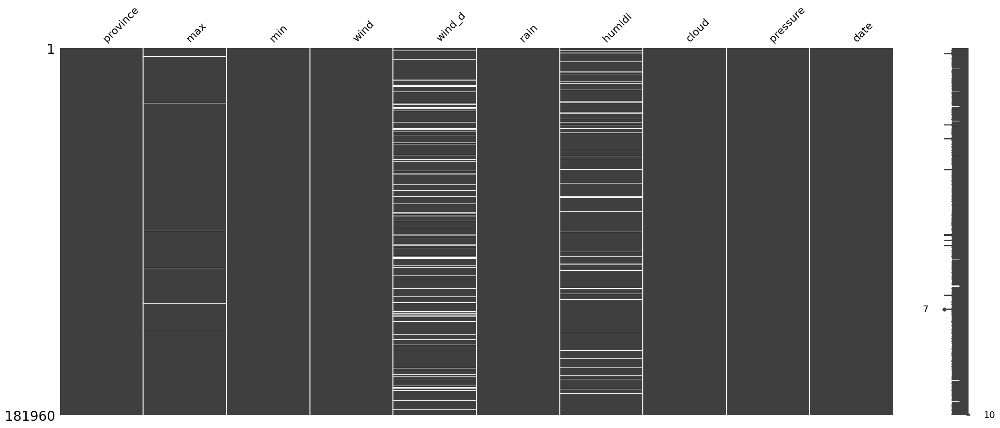

In [ ]:
# Check null/missing valaue
msno.matrix(df)

In [69]:
# Save nosing data
path = "nosing_data.csv"
df.to_csv(path)

# Visualize

In [ ]:
def create_logical_array(size, index):
    logical_array = np.full(size, False)
    
    logical_array[index] = True
    
    return logical_array.tolist()

Nominal feature 

In [ ]:
# win_d histogram plot

fig = go.Figure()

num_province = len(provinces)

button_list = list([
    dict(label = 'All',
         method = 'update',
         args = [{'visible': [True]*num_province},
          {'showlegend':True}])
    ])

for i in range(num_province):
    fig.add_trace(
        go.Histogram(x=df[df['province']==provinces[i]]['wind_d'])
    )

    button_list.append(
        dict(label = provinces[i],
             method = 'update',
             args = [{'visible': create_logical_array(num_province, i)}])
    )
    
fig.update_layout(
    updatemenus=[go.layout.Updatemenu(
        active=0,
        buttons=button_list
        )
    ])

fig.show()

In [ ]:
# wind_d count

df_wind = df.groupby('province')['wind_d'].value_counts().unstack()
df_wind

wind_d,E,ENE,ESE,N,NE,NNE,NNW,NW,S,SE,SSE,SSW,SW,W,WNW,WSW
province,,,,,,,,,,,,,,,,
Bac Lieu,896.0,422.0,488.0,NaN,34.0,5.0,6.0,8.0,116.0,204.0,140.0,167.0,459.0,296.0,42.0,800.0
Ben Tre,600.0,184.0,745.0,NaN,23.0,9.0,8.0,23.0,164.0,377.0,219.0,240.0,489.0,204.0,57.0,774.0
Bien Hoa,352.0,151.0,576.0,NaN,37.0,12.0,8.0,22.0,245.0,630.0,394.0,309.0,480.0,204.0,59.0,635.0
Buon Me Thuot,739.0,1187.0,117.0,NaN,57.0,2.0,NaN,NaN,152.0,68.0,107.0,407.0,841.0,46.0,14.0,355.0
Ca Mau,798.0,408.0,488.0,NaN,78.0,35.0,1.0,3.0,128.0,214.0,156.0,206.0,414.0,372.0,78.0,747.0
Cam Pha,431.0,837.0,357.0,6.0,713.0,171.0,3.0,5.0,483.0,303.0,319.0,216.0,131.0,24.0,19.0,78.0
Cam Ranh,154.0,216.0,196.0,96.0,126.0,686.0,5.0,10.0,423.0,271.0,312.0,751.0,674.0,29.0,7.0,125.0
Can Tho,573.0,198.0,718.0,2.0,43.0,17.0,2.0,15.0,141.0,328.0,200.0,231.0,500.0,199.0,33.0,851.0
Chau Doc,215.0,181.0,344.0,2.0,101.0,122.0,7.0,10.0,311.0,493.0,410.0,355.0,677.0,141.0,32.0,723.0


Numerical feature

In [ ]:
# selected province

plot_province = 'Bac Lieu'
df_p = df[df['province']==plot_province]
df_p = df_p.sort_values(['province', 'date'])

In [ ]:
df_p

,province,max,min,wind,wind_d,rain,humidi,cloud,pressure,date
0,Bac Lieu,27.0,22,17,NNE,6.9,90.0,71,1010,2009-01-01
117,Bac Lieu,28.0,22,15,ENE,0.5,85.0,61,1010,2009-01-02
91,Bac Lieu,23.0,21,9,ESE,16.7,91.0,77,1011,2009-01-03
104,Bac Lieu,27.0,21,9,E,2.2,86.0,32,1011,2009-01-04
39,Bac Lieu,29.0,22,10,SE,0.0,81.0,25,1010,2009-01-05
...,...,...,...,...,...,...,...,...,...,...
2118,Bac Lieu,33.0,26,11,SSW,1.5,71.0,48,1009,2021-06-14
2194,Bac Lieu,31.0,26,12,W,1.3,75.0,43,1008,2021-06-15
2304,Bac Lieu,34.0,26,11,WSW,3.7,74.0,48,1009,2021-06-16
2144,Bac Lieu,33.0,27,14,W,0.5,69.0,45,1009,2021-06-17


In [ ]:
# Scatter plot

fig = go.Figure()

num_feature = len(numerical_feature)

button_list = list(
            [dict(label = 'All',
                  method = 'update',
                  args = [{'visible': [True]*num_feature},
                          {'showlegend':True}])
            ])

for i in range(num_feature):
    fig.add_trace(
        go.Scatter(
            x = df_p.date,
            y = df_p[numerical_feature[i]],
            name = numerical_feature[i]
        )
    )

    button_list.append(
        dict(label = numerical_feature[i],
             method = 'update',
             args = [{'visible': create_logical_array(num_feature, i)},
              {'showlegend':True}])
    )
    
fig.update_layout(
    updatemenus=[go.layout.Updatemenu(
        active=0,
        buttons=button_list
        )
    ])

fig.show()

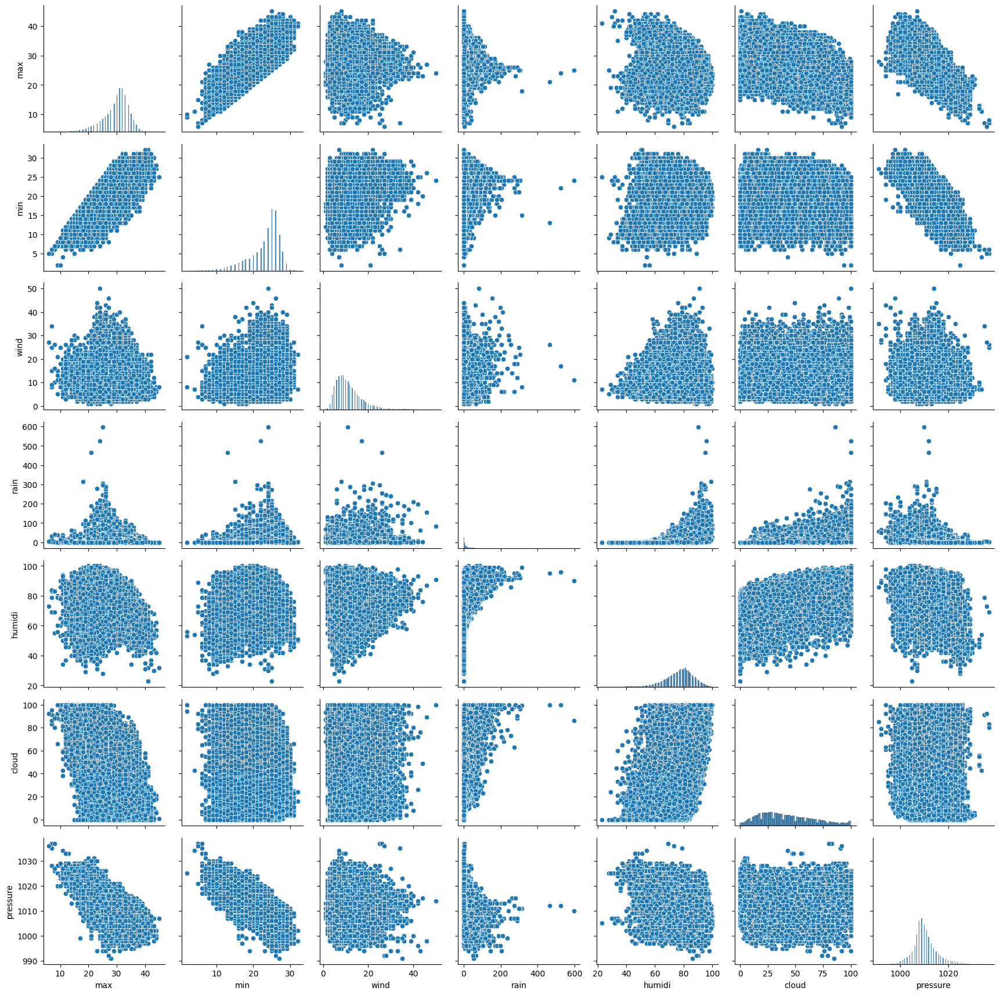

In [ ]:
# Scatter matrix plot

g = sns.PairGrid(df.sample(frac=0.3))
g.map_diag(sns.histplot)
g.map_offdiag(sns.scatterplot)

In [ ]:
# box plot

fig = go.Figure()

num_feature = len(numerical_feature)

button_list = list([])

for i in range(num_feature):
  fig.add_trace(
      go.Box(x = df['province'],
             y=df[numerical_feature[i]])
      )
  
  button_list.append(
      dict(label = numerical_feature[i],
           method = 'update',
           args = [{'visible': create_logical_array(num_feature, i)}]
           )
      )
    
fig.update_layout(
    updatemenus=[go.layout.Updatemenu(
        active=0,
        buttons=button_list,
        y=1
        )
    ])

fig.show()

In [ ]:
# outliers count

Q1 = df[numerical_feature].quantile(0.25)
Q3 = df[numerical_feature].quantile(0.75)
IQR = Q3 - Q1

In [ ]:
df_outliers = df[['province']+numerical_feature]

grouped = df_outliers.groupby('province')

outliers_count = grouped.apply(lambda x: ((x < (Q1 - 1.5 * IQR)) | (x > (Q3 + 1.5 * IQR))).sum()).drop('province', axis=1)

In [ ]:
outliers_count

,cloud,humidi,max,min,pressure,rain,wind
province,,,,,,,
Bac Lieu,0,1,0,0,0,91,209
Ben Tre,0,6,1,0,0,45,13
Bien Hoa,0,67,1,0,0,582,1
Buon Me Thuot,0,56,24,29,9,650,0
Ca Mau,0,0,0,0,0,285,176
Cam Pha,0,83,843,253,1053,534,105
Cam Ranh,0,0,0,0,6,460,687
Can Tho,0,8,0,0,0,74,18
Chau Doc,0,53,0,0,0,404,11


In [ ]:
print("Total outliers:\n")
print(outliers_count.sum())
print('\nTotal:', sum(outliers_count.sum()))

Total outliers:

cloud           0
humidi       2043
max          8577
min          5200
pressure    14552
rain        17147
wind         4213
dtype: int64

Total: 51732


Correlation 

<ipython-input-66-74a3f1691aa2>:2: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



<Axes: >

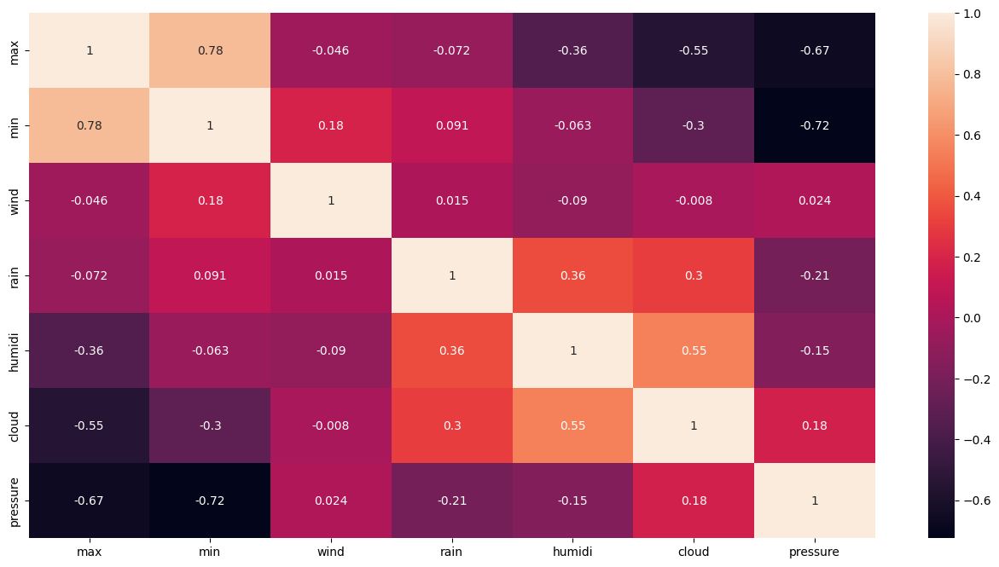

In [ ]:
plt.figure(figsize=(16, 8))
corr = df.corr()
sns.heatmap(corr, annot=True)

# Preprocessing 